# **Introduction**

The credit card crisis had been an issue for Taiwan since 2006. According to the article [1]“Taiwan’s Credit Card Crisis”, over a half million people were not able to repay their debt and the amount of loan on credit cards and cash cards reached $268 billion USD. This serves as an alert to the issuers that identifying unqualified and risky customers with adequate background checks becomes essential before approving credit card applications [2](Sharma & Mehra, 2018). 

While accurately identifying potential defaulters can be a challenge for the creditors, we built an engine to predict whether a credit card user will be default in the next month to address the above issue. Many data scientists have used basic machine learning models to tackle this problem. For example, [3]Neema et al. (2017) in their paper introduced 7 machine learning models including Logistic Regression, Decision Tree, Random Forest, K-Nearest Neighbor, and so forth. In our project, we will apply the Feed-Forward Neural Network(FFNN) algorithms to classify the target variable.
 
[4]In recent years, deep learning has been widely used in different areas such as computer visions, image processing, classification, and prediction tasks(Huang et al., 2020). [5]According to Hsu et al. (2019), with the rapidly increasing amount of customer data and fast-growing financial activities, applying deep learning models shows the capability to extract high-level information.


# **Literature Review**

[6] This article did recent research on evaluating/encoding categorical data for neural networks. (Hancock & Khoshgoftaar, 2020)


[7] This article did original research on comparing different machine learning techniques for predicting credit card default.


[8] This article also discussed the credit card default issue and the author utilized a combination of the traditional machine learning models and ensemble models such as Extremely Randomized Trees (ET).


[9] This article introduces the approach of artificial neural network (ANN) to estimate the real probability of default.  (Chishti & Awan, 2019)

[10] The author of this article used the basic machine learning models such as random forest, logistic regression, and decision tree to tackle the credit card default prediction and achieved an accuracy of 82%. We can use it as a benchmark to compare our results. (Sayjadah et al., 2018)


# URL for dataset
https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients




# Data Gathering and Description 
- The dataset represents payment history gathered October 2005 of $30,000$ credit card customers for a major bank in Taiwan. It includes an indicator for those customers who defaulted on their payment the following month which was 6,636 customers or near $~22$% of all credit card holders in this data.

- The data includes features related to a combination of the individual and family's total credit (NT Dollar). Demographic information for each customer including sex (M or F), education level, marriage, and age.

 - The customers payments and their respective bills are recorded for several months between April 2005 and September 2005. These payments each have a corresponding status measuring the number of months payment has been delayed. All features are listed below with their description:

**ID**: Identifier

**LIMIT_BAL**: Amount of the given credit (NT dollar): it includes both the individual consumer credit and his/her family (supplementary) credit.

**SEX**: Gender (1 = male; 2 = female)

**EDUCATION**: (1 = graduate school; 2 = university; 3 = high school; 4 = others)

**MARRIAGE**: Marital status (1 = married; 2 = single; 3 = others)

**AGE**: (year of age)

**PAY_0...PAY_6**: repayment status April-September 2005: (-1 = pay duly; 1 = payment delay for one month; 2 = payment delay for two months; \
8 = payment delay for eight months; 9 = payment delay for nine months and above)

**BILL_AMT1...BILL_AMT6**: Amount of bill statement each month April-September 2005.

**PAY_AMT1...PAY_AMT6**: Amount of previous payments each month April-September 2005.

**default payment next month** (1=default, 0=no default)

## How we made it our own:
**LIMIT_BAL**: Transformed to range between 0 and 1 so that single observations with larger amounts of credit would not dominate our model.\
**SEX**: Recoded to dummy variables (Male 1=Yes, 0=No), (Female 1=Yes, 0=No) with intention of leaving one out for modeling.\
**EDUCATION**: Recoded to dummy variables for each level of education.\
**MARRIAGE**: Recoded to dummy variables for each level of marriage.\
**AGE**: Transformed to range between 0 and 1 for feeding to neural network.\
**PAY_0...PAY_6**: Transformed to range between 0 and 1 to have nonnegative values and still represent number of delayed payments.\
**BILL_AMT1...BILL_AMT6**: Transformed to range between 0 and 1 to minimize large bill amounts weight on model.\
**PAY_AMT1...PAY_AMT6**: Transformed to range between 0 and 1 to minimize large payment amounts weight on model.

**Added Variables**:\
**NET_AMT1...NETAMT6**: The net amount remaining after a payment was made towards respective bill for each month. Later scaled to range between 0 and 1.
**PARTIAL_PAY_CNT_TOTAL**: The number of monthly payments where the bill was not fully paid (using created net amount). Later scaled to range between 0 and 1.

**Notes**:
* We recoded many of our categorical variables so that the magnitude of their encoded levels would not affect the output of the model. (Why should high school have more weight than graduate school numerically?). We have a great article in our literature review that discusses this as well.

* We also transformed many of the continous variables to be on a scale of 0 to 1 
since large bills and payments would have larger swings in error as our model updates.

* We explored the possibility of including Macroeconomic data related to lender/borrower interest rates and currency exchange rates but decided this would be consistent across all individuals. (Suggested by another article in our literature review)


# 1.EDA


## 1.1 loading the dataset and reading the file 


In [1]:
from google.colab import files
files.upload()

Saving default of credit card clients.xls to default of credit card clients (1).xls


{'default of credit card clients.xls': b'\xd0\xcf\x11\xe0\xa1\xb1\x1a\xe1\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00>\x00\x03\x00\xfe\xff\t\x00\x06\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00U\x00\x00\x00B*\x00\x00\x00\x00\x00\x00\x00\x10\x00\x00\xfe\xff\xff\xff\x00\x00\x00\x00\xfe\xff\xff\xff\x00\x00\x00\x00\xed)\x00\x00\xee)\x00\x00\xef)\x00\x00\xf0)\x00\x00\xf1)\x00\x00\xf2)\x00\x00\xf3)\x00\x00\xf4)\x00\x00\xf5)\x00\x00\xf6)\x00\x00\xf7)\x00\x00\xf8)\x00\x00\xf9)\x00\x00\xfa)\x00\x00\xfb)\x00\x00\xfc)\x00\x00\xfd)\x00\x00\xfe)\x00\x00\xff)\x00\x00\x00*\x00\x00\x01*\x00\x00\x02*\x00\x00\x03*\x00\x00\x04*\x00\x00\x05*\x00\x00\x06*\x00\x00\x07*\x00\x00\x08*\x00\x00\t*\x00\x00\n*\x00\x00\x0b*\x00\x00\x0c*\x00\x00\r*\x00\x00\x0e*\x00\x00\x0f*\x00\x00\x10*\x00\x00\x11*\x00\x00\x12*\x00\x00\x13*\x00\x00\x14*\x00\x00\x15*\x00\x00\x16*\x00\x00\x17*\x00\x00\x18*\x00\x00\x19*\x00\x00\x1a*\x00\x00\x1b*\x00\x00\x1c*\x00\x00\x1d*\x00\x00\x1e*\x00\x00\x1f*\x00\x00 *\x00\x00!*

In [2]:
import pandas as pd # importing pandas 
df = pd.read_excel('default of credit card clients.xls') # reading the xls file 

# renaming the columns 
df.rename(columns={'Unnamed: 0':'ID','X1':'LIMIT_BAL','X2':'SEX','X3':'EDUCATION','X4':'MARRIAGE','X5':'AGE','X6':'PAY_0','X7':'PAY_2','X8':'PAY_3','X9':'PAY_4','X10':'PAY_5','X11':'PAY_6','X12':'BILL_AMT1','X13':'BILL_AMT2','X14':'BILL_AMT3','X14':'BILL_AMT3','X15':'BILL_AMT4','X16':'BILL_AMT5','X17':'BILL_AMT6','X18':'PAY_AMT1','X19':'PAY_AMT2','X20':'PAY_AMT3','X21':'PAY_AMT4','X22':'PAY_AMT5','X23':'PAY_AMT6','Y':'default payment next month'}, inplace=True)


In [3]:
# removing the first row 
df = df[1:]


## 1.2 Exploring the data


In [4]:
# viewing the data
df.head(20)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
1,2,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0
5,6,50000,1,1,2,37,0,0,0,0,0,0,64400,57069,57608,19394,19619,20024,2500,1815,657,1000,1000,800,0
6,7,500000,1,1,2,29,0,0,0,0,0,0,367965,412023,445007,542653,483003,473944,55000,40000,38000,20239,13750,13770,0
7,8,100000,2,2,2,23,0,-1,-1,0,0,-1,11876,380,601,221,-159,567,380,601,0,581,1687,1542,0
8,9,140000,2,3,1,28,0,0,2,0,0,0,11285,14096,12108,12211,11793,3719,3329,0,432,1000,1000,1000,0
9,10,20000,1,3,2,35,-2,-2,-2,-2,-1,-1,0,0,0,0,13007,13912,0,0,0,13007,1122,0,0
10,11,200000,2,3,2,34,0,0,2,0,0,-1,11073,9787,5535,2513,1828,3731,2306,12,50,300,3738,66,0


In [5]:
# check the shape of our data
df.shape

(29999, 25)

In [6]:
# check the data types
df.info() # there is no null value in our dataset 


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29999 entries, 1 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   ID                          29999 non-null  int64
 1   LIMIT_BAL                   29999 non-null  int64
 2   SEX                         29999 non-null  int64
 3   EDUCATION                   29999 non-null  int64
 4   MARRIAGE                    29999 non-null  int64
 5   AGE                         29999 non-null  int64
 6   PAY_0                       29999 non-null  int64
 7   PAY_2                       29999 non-null  int64
 8   PAY_3                       29999 non-null  int64
 9   PAY_4                       29999 non-null  int64
 10  PAY_5                       29999 non-null  int64
 11  PAY_6                       29999 non-null  int64
 12  BILL_AMT1                   29999 non-null  int64
 13  BILL_AMT2                   29999 non-null  int64
 14  BILL_A

In [7]:
cols = df.columns[df.dtypes.eq('object')] # converting the data type to nmumeric
df[cols] = df[cols].apply(pd.to_numeric, errors='coerce')

In [8]:
# check the value counts of our target variable default payment next month to see if its imbalanced data or not 
df['default payment next month'].value_counts()

0    23364
1     6635
Name: default payment next month, dtype: int64

We have an **imbalanced data**! In the next section we will see how to resolve such problems


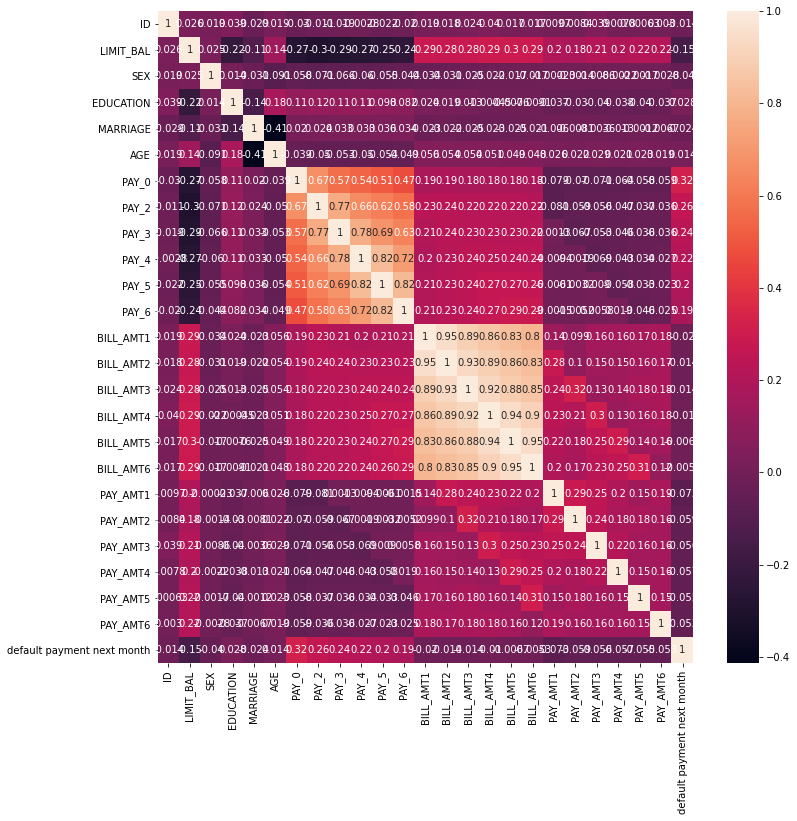

In [9]:
# checking the correlation now 
import seaborn as sns
import matplotlib.pyplot as plt # for plotting
corr = df.corr()
fig,ax= plt.subplots(figsize=(12,12))
sns.heatmap(corr, 
            annot=True)

In [10]:
# finding out the stats for data
df.describe()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
count,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000,2.999900e+04,29999.000000,29999.000000,29999.000000,29999.000000,2.999900e+04,29999.000000,29999.000000,29999.000000,29999.000000,29999.000000
mean,15001.000000,167489.238975,1.603720,1.853128,1.551885,35.485883,-0.016767,-0.133838,-0.166172,-0.220641,-0.266142,-0.291043,51224.907964,49180.611120,4.701470e+04,43264.391113,40312.744725,38873.056169,5663.769292,5.921338e+03,5225.855695,4826.237741,4799.547618,5215.676423,0.221174
std,8660.109699,129747.029798,0.489132,0.790361,0.521969,9.217819,1.123760,1.197143,1.196878,1.169149,1.133162,1.149964,73636.581260,71174.457875,6.935003e+04,64333.443473,60797.723604,59554.677258,16563.524146,2.304123e+04,17607.229085,15666.396081,15278.535203,17777.736580,0.415044
min,2.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-165580.000000,-69777.000000,-1.572640e+05,-170000.000000,-81334.000000,-339603.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7501.500000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,3558.500000,2984.500000,2.667500e+03,2328.000000,1763.500000,1256.000000,1000.000000,8.330000e+02,390.000000,296.000000,253.500000,118.000000,0.000000
50%,15001.000000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,22382.000000,21203.000000,2.008900e+04,19052.000000,18105.000000,17074.000000,2100.000000,2.009000e+03,1800.000000,1500.000000,1500.000000,1500.000000,0.000000
75%,22500.500000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,67092.000000,64008.500000,6.016550e+04,54509.000000,50196.000000,49200.500000,5006.000000,5.000000e+03,4505.000000,4013.500000,4032.000000,4000.000000,0.000000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,964511.000000,983931.000000,1.664089e+06,891586.000000,927171.000000,961664.000000,873552.000000,1.684259e+06,896040.000000,621000.000000,426529.000000,528666.000000,1.000000


We dont have mising values but we have anomalous things 
 - **Education** has category 5 and 6 which are not labelled and also category 0 is undocumented 
 - **Marriage** has label 0 which is undocumented
 - **Payment** delay columns starting with Pay_1 .... Pay_6 are the months of delay but have undocumented value -2 also every negative value should be treated 0 assuming its being paid off 


# 2.Data Pre-Processing
 
As seen previously some categoris are mislabeled or undocumented. 
- The 0 in marriage can be categorize as other (naming it 3)
- The 0, 5 and 6 in education can be catgorize into one category namely 'other'


In [11]:
fil = (df.EDUCATION == 5) | (df.EDUCATION == 6) | (df.EDUCATION == 0)
df.loc[fil, 'EDUCATION'] = 4
df.EDUCATION.value_counts()

2    14029
1    10585
3     4917
4      468
Name: EDUCATION, dtype: int64

In [12]:
df.loc[df.MARRIAGE == 0, 'MARRIAGE'] = 3
df.MARRIAGE.value_counts()

2    15964
1    13658
3      377
Name: MARRIAGE, dtype: int64

According to the data and documentation, the Pay_N indicates the number of months of delay in payment and -1 indicates the payment is done. we need to adjust 0 and -2 which are undocumented and make it as pay duly by labeling it as 0 even -1 

In [13]:
fil = (df.PAY_0 == -2) | (df.PAY_0 == -1) | (df.PAY_0 == 0) # or condition for the fill statement
df.loc[fil, 'PAY_1'] = 0 # using loc to identify the rows where condition is satisfied
fil = (df.PAY_2 == -2) | (df.PAY_2 == -1) | (df.PAY_2 == 0)
df.loc[fil, 'PAY_2'] = 0
fil = (df.PAY_3 == -2) | (df.PAY_3 == -1) | (df.PAY_3 == 0)
df.loc[fil, 'PAY_3'] = 0
fil = (df.PAY_4 == -2) | (df.PAY_4 == -1) | (df.PAY_4 == 0)
df.loc[fil, 'PAY_4'] = 0
fil = (df.PAY_5 == -2) | (df.PAY_5 == -1) | (df.PAY_5 == 0)
df.loc[fil, 'PAY_5'] = 0
fil = (df.PAY_6 == -2) | (df.PAY_6 == -1) | (df.PAY_6 == 0)
df.loc[fil, 'PAY_6'] = 0



In [14]:
# checking the columns of the dataset 
df.columns

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default payment next month', 'PAY_1'],
      dtype='object')

In [15]:
# converting the data type to object
df[['ID', 'SEX', 'EDUCATION','MARRIAGE','PAY_0','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']] = df[['ID', 'SEX', 'EDUCATION','MARRIAGE','PAY_0','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']].astype(str)

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29999 entries, 1 to 29999
Data columns (total 26 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ID                          29999 non-null  object 
 1   LIMIT_BAL                   29999 non-null  int64  
 2   SEX                         29999 non-null  object 
 3   EDUCATION                   29999 non-null  object 
 4   MARRIAGE                    29999 non-null  object 
 5   AGE                         29999 non-null  int64  
 6   PAY_0                       29999 non-null  object 
 7   PAY_2                       29999 non-null  object 
 8   PAY_3                       29999 non-null  object 
 9   PAY_4                       29999 non-null  object 
 10  PAY_5                       29999 non-null  object 
 11  PAY_6                       29999 non-null  object 
 12  BILL_AMT1                   29999 non-null  int64  
 13  BILL_AMT2                   299

In [17]:
df.drop(['ID'], axis =1) # drop the id variable 

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month,PAY_1
1,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1,0.0
2,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0,0.0
3,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0,0.0
4,50000,1,2,1,57,-1,0,0,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0,0.0
5,50000,1,1,2,37,0,0,0,0,0,0,64400,57069,57608,19394,19619,20024,2500,1815,657,1000,1000,800,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000,1,3,1,39,0,0,0,0,0,0,188948,192815,208365,88004,31237,15980,8500,20000,5003,3047,5000,1000,0,0.0
29996,150000,1,3,2,43,-1,0,0,0,0,0,1683,1828,3502,8979,5190,0,1837,3526,8998,129,0,0,0,0.0
29997,30000,1,2,2,37,4,3,2,0,0,0,3565,3356,2758,20878,20582,19357,0,0,22000,4200,2000,3100,1,NaN
29998,80000,1,3,1,41,1,0,0,0,0,0,-1645,78379,76304,52774,11855,48944,85900,3409,1178,1926,52964,1804,1,NaN


## 2.1 Recoding the categorical variables


In [18]:
X_dummies = pd.get_dummies(df[['SEX', 'EDUCATION','MARRIAGE','PAY_0','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']])
X_numeric = df[['LIMIT_BAL','AGE', 
       'BILL_AMT1','BILL_AMT2', 'BILL_AMT3',
       'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6','PAY_AMT1','PAY_AMT2','PAY_AMT3','PAY_AMT4','PAY_AMT5','PAY_AMT6']]

In [19]:
# concat numeric and categorical features into X
X = pd.concat([X_dummies, X_numeric], axis=1)
X
Y = df['default payment next month']

In [20]:
# check the shape
print(X_dummies.shape)
print(X_numeric.shape)
print(X.shape)

(29999, 63)
(29999, 14)
(29999, 77)


In [21]:
import numpy as np

# convert them to numpy array
X = np.array(X)
y = np.array(Y)

## 2.2 Balancing the dataset


We saw that our dataset is imbalanced and since our target object is 1 whether the default will happen or not we will be using random under sampler to balance the data

In [22]:
from imblearn.under_sampling import RandomUnderSampler
Undersampler = RandomUnderSampler(ratio='auto') 
X, y = Undersampler.fit_sample(X, y)

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


# 3.Modeling 


## 3.1 Splitting the dataset


In [23]:
from sklearn.model_selection import train_test_split
validation_size = 0.20
seed = 7
X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=validation_size, random_state=seed)
print(X_train.shape, X_test.shape, Y_train.shape, Y_test.shape)

(10616, 77) (2654, 77) (10616,) (2654,)


In [24]:
# check the shape of training set after resampling
print('After UnderSampling, the shape of train_X: {}'.format(X_train.shape)) 
print('After UnderSampling, the shape of train_y: {} \n'.format(Y_train.shape)) 

# check the counts of 1 and 0 in the training set after resampling
print("After UnderSampling, counts of label '1': {}".format(sum(Y_train == 1))) 
print("After underSampling, counts of label '0': {}".format(sum(Y_train == 0)))

After UnderSampling, the shape of train_X: (10616, 77)
After UnderSampling, the shape of train_y: (10616,) 

After UnderSampling, counts of label '1': 5301
After underSampling, counts of label '0': 5315


## 3.2 Data Transformation

In [25]:
from sklearn.preprocessing import MinMaxScaler
min_max_scaler = MinMaxScaler()
X_train = min_max_scaler.fit_transform(X_train)
X_test = min_max_scaler.transform(X_test)

## 3.3 Model 0

In [26]:
#build model
from keras.models import Sequential
from keras.layers import Dense, Dropout

model = Sequential()
model.add(Dense(458, input_shape=(X_train.shape[1],), activation='relu')) # tune number of nodes for input and hidden layers for test
model.add(Dense(230,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(123,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(46,activation='relu'))

model.add(Dense(1, activation='sigmoid')) #sigmoid for classification output
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 458)               35724     
_________________________________________________________________
dense_1 (Dense)              (None, 230)               105570    
_________________________________________________________________
dropout (Dropout)            (None, 230)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 123)               28413     
_________________________________________________________________
dropout_1 (Dropout)          (None, 123)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 46)                5704      
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 4

In [27]:
from keras.callbacks import EarlyStopping
es = EarlyStopping(monitor='val_accuracy', 
                                   mode='max', 
                                   patience=10,
                                   restore_best_weights=True)

# compile the model
model.compile(optimizer='Adam', 
              loss='binary_crossentropy',
              metrics=['accuracy'])

# fit our first model
history = model.fit(X_train, Y_train,
                    validation_data = (X_test, Y_test),
                    callbacks=[es],
                    epochs=1000,
                    batch_size=8,
                    shuffle=True,
                    verbose=1)

Epoch 1/1000
1327/1327 [==============================] - 6s 5ms/step - loss: 0.5962 - accuracy: 0.6899 - val_loss: 0.5929 - val_accuracy: 0.6937
Epoch 2/1000
1327/1327 [==============================] - 6s 4ms/step - loss: 0.5841 - accuracy: 0.7005 - val_loss: 0.5781 - val_accuracy: 0.6971
Epoch 3/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5809 - accuracy: 0.6994 - val_loss: 0.5723 - val_accuracy: 0.7057
Epoch 4/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5757 - accuracy: 0.7013 - val_loss: 0.5943 - val_accuracy: 0.7038
Epoch 5/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5742 - accuracy: 0.7059 - val_loss: 0.5712 - val_accuracy: 0.7031
Epoch 6/1000
1327/1327 [==============================] - 3s 3ms/step - loss: 0.5721 - accuracy: 0.7051 - val_loss: 0.5744 - val_accuracy: 0.7031
Epoch 7/1000
1327/1327 [==============================] - 3s 3ms/step - loss: 0.5682 - accuracy: 0.7050 - val_loss: 0.5831 -

### 3.3.1 Model Visualization

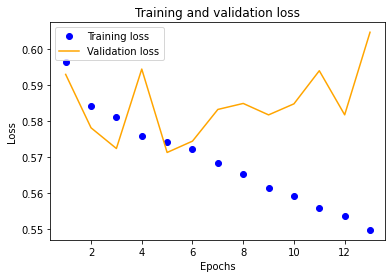

In [28]:
# let's see the training and validation loss by epoch
history_dict = history.history
loss_values = history_dict['loss'] 
val_loss_values = history_dict['val_loss'] 
epochs = range(1, len(loss_values) + 1) 
plt.plot(epochs, loss_values, 'bo', label='Training loss')
plt.plot(epochs, val_loss_values, 'orange', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

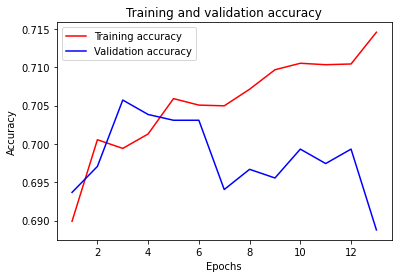

In [29]:
# learning curve

# accuracy
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

# loss
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

### 3.3.2 Model Evaluation

In [30]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score

# Train Set evaluation
# Round to a whole number (0 or 1)
train_preds = np.round(model.predict(X_train),0)

# confusion matrix
confusion_matrix(Y_train, train_preds)

array([[4259, 1056],
       [2041, 3260]])

In [31]:
# validation set evaluation
# Round to a whole number (0 or 1)
preds = np.round(model.predict(X_test),0)

# confusion matrix
confusion_matrix(Y_test, preds)


array([[1063,  257],
       [ 524,  810]])

In [32]:
print(classification_report(Y_test, preds))

              precision    recall  f1-score   support

           0       0.67      0.81      0.73      1320
           1       0.76      0.61      0.67      1334

    accuracy                           0.71      2654
   macro avg       0.71      0.71      0.70      2654
weighted avg       0.71      0.71      0.70      2654



> **1st Model Results:**

*   Good overall performance!
*   The 1st model we built starts with a accuracy of 71%. And a good recall of 0s of 81% and 1s of 61%.
*   Lets see if we can do better at predicting 1's which is the group about whether the person will default or not

## 3.4 Model 1


In [33]:
# check the shape of input to decide hidden unit number
X_train.shape

(10616, 77)

In [34]:
#build model
from keras.models import Sequential
from keras.layers import Dense

model = Sequential()
model.add(Dense(458, input_shape=(X_train.shape[1],), activation='relu')) # tune number of nodes for input and hidden layers for test
model.add(Dense(230,activation='tanh'))
model.add(Dropout(0.2))
model.add(Dense(123,activation='tanh'))
model.add(Dropout(0.2))
model.add(Dense(46,activation='tanh'))

model.add(Dense(1, activation='sigmoid')) #sigmoid for classification output
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_5 (Dense)              (None, 458)               35724     
_________________________________________________________________
dense_6 (Dense)              (None, 230)               105570    
_________________________________________________________________
dropout_2 (Dropout)          (None, 230)               0         
_________________________________________________________________
dense_7 (Dense)              (None, 123)               28413     
_________________________________________________________________
dropout_3 (Dropout)          (None, 123)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 46)                5704      
_________________________________________________________________
dense_9 (Dense)              (None, 1)                

In [35]:
# use early stopping callback
from keras.callbacks import EarlyStopping
es = EarlyStopping(monitor='val_accuracy', 
                                   mode='max', 
                                   patience=10,
                                   restore_best_weights=True)

# compile the model
model.compile(optimizer='Adam', 
              loss='binary_crossentropy',
              metrics=['accuracy'])

# fit our first model
history = model.fit(X_train, Y_train,
                    validation_data = (X_test, Y_test),
                    callbacks=[es],
                    epochs=1000,
                    batch_size=8,
                    shuffle=True,
                    verbose=1)

Epoch 1/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.6031 - accuracy: 0.6847 - val_loss: 0.5795 - val_accuracy: 0.6993
Epoch 2/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5891 - accuracy: 0.6950 - val_loss: 0.5838 - val_accuracy: 0.7027
Epoch 3/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5838 - accuracy: 0.6991 - val_loss: 0.5761 - val_accuracy: 0.6989
Epoch 4/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5831 - accuracy: 0.6970 - val_loss: 0.5777 - val_accuracy: 0.6914
Epoch 5/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5807 - accuracy: 0.6993 - val_loss: 0.5770 - val_accuracy: 0.6956
Epoch 6/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5762 - accuracy: 0.6991 - val_loss: 0.5713 - val_accuracy: 0.7054
Epoch 7/1000
1327/1327 [==============================] - 4s 3ms/step - loss: 0.5775 - accuracy: 0.6983 - val_loss: 0.5763 -

### 3.4.1 Model Visualization


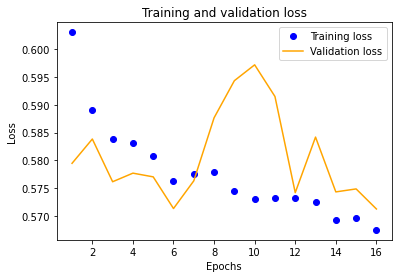

In [36]:
# let's see the training and validation loss by epoch
history_dict = history.history
loss_values = history_dict['loss'] 
val_loss_values = history_dict['val_loss'] 
epochs = range(1, len(loss_values) + 1) 
plt.plot(epochs, loss_values, 'bo', label='Training loss')
plt.plot(epochs, val_loss_values, 'orange', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

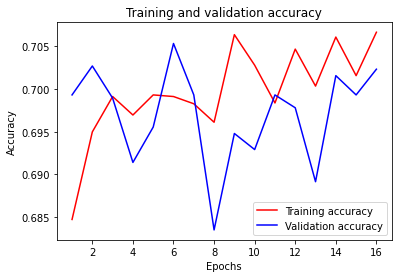

In [37]:
# learning curve

# accuracy
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

# loss
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

### 3.4.2 Model Evaluation


In [38]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score

# Train Set evaluation
# Round to a whole number (0 or 1)
train_preds = np.round(model.predict(X_train),0)

# confusion matrix
confusion_matrix(Y_train, train_preds)

array([[4295, 1020],
       [2061, 3240]])

In [39]:
# validation set evaluation
# Round to a whole number (0 or 1)
preds = np.round(model.predict(X_test),0)

# confusion matrix
confusion_matrix(Y_test, preds)


array([[1065,  255],
       [ 527,  807]])

In [40]:
# the performance of classification
print(classification_report(Y_test, preds))

              precision    recall  f1-score   support

           0       0.67      0.81      0.73      1320
           1       0.76      0.60      0.67      1334

    accuracy                           0.71      2654
   macro avg       0.71      0.71      0.70      2654
weighted avg       0.71      0.71      0.70      2654




> **2nd Model Results:**



*   The precision of 1's and 0's remains same
*   The recall of 1's drop by 1% 
*   The accuracy remains at the same level: 71%.
*   As we can see using tanH as the activation function did not make much of a difference to our model results
* Lets see if we can improve accuracy using rmsprop as optimizer


## 3.5 Model 2

In [41]:
# Adding dropouts of 0.2 between each hidden layer

In [42]:
#build model
from keras.layers import Dense, Dropout

model = Sequential()
model.add(Dense(1300, input_shape=(X.shape[1],), activation='relu')) # tune number of nodes for input and hidden layers for test
model.add(Dropout(0.2))
model.add(Dense(889,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(593,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(396,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(264,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(176,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(118,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(79,activation='relu'))


model.add(Dense(1, activation='sigmoid')) #sigmoid for classification output
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 1300)              101400    
_________________________________________________________________
dropout_4 (Dropout)          (None, 1300)              0         
_________________________________________________________________
dense_11 (Dense)             (None, 889)               1156589   
_________________________________________________________________
dropout_5 (Dropout)          (None, 889)               0         
_________________________________________________________________
dense_12 (Dense)             (None, 593)               527770    
_________________________________________________________________
dropout_6 (Dropout)          (None, 593)               0         
_________________________________________________________________
dense_13 (Dense)             (None, 396)              

In [43]:
# early stopping callback
es = EarlyStopping(monitor='val_accuracy', 
                                    mode='max', 
                                    patience=7,
                                    restore_best_weights=True)

# compile the model
model.compile(optimizer='rmsprop', 
                loss='binary_crossentropy',
                metrics=['accuracy'])

# fit our first model
history = model.fit(X_train, Y_train,
                      validation_data = (X_test, Y_test),
                      callbacks=[es],
                      epochs=1000,
                      batch_size=16,
                      shuffle=True,
                      verbose=1)

Epoch 1/1000
664/664 [==============================] - 20s 30ms/step - loss: 0.6213 - accuracy: 0.6883 - val_loss: 0.7713 - val_accuracy: 0.7020
Epoch 2/1000
664/664 [==============================] - 19s 29ms/step - loss: 0.6103 - accuracy: 0.6985 - val_loss: 0.5865 - val_accuracy: 0.7008
Epoch 3/1000
664/664 [==============================] - 19s 29ms/step - loss: 0.6226 - accuracy: 0.6973 - val_loss: 0.6233 - val_accuracy: 0.7001
Epoch 4/1000
664/664 [==============================] - 19s 29ms/step - loss: 0.6163 - accuracy: 0.6982 - val_loss: 0.5956 - val_accuracy: 0.7023
Epoch 5/1000
664/664 [==============================] - 19s 29ms/step - loss: 0.6315 - accuracy: 0.6963 - val_loss: 0.5969 - val_accuracy: 0.7023
Epoch 6/1000
664/664 [==============================] - 19s 28ms/step - loss: 0.6565 - accuracy: 0.6968 - val_loss: 0.6110 - val_accuracy: 0.7023
Epoch 7/1000
664/664 [==============================] - 19s 29ms/step - loss: 0.6505 - accuracy: 0.6981 - val_loss: 0.6206 -

### 3.5.1 Model Visualization 


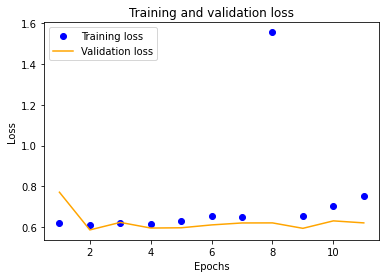

In [44]:
# let's see the training and validation loss by epoch
history_dict = history.history
loss_values = history_dict['loss'] 
val_loss_values = history_dict['val_loss'] 
epochs = range(1, len(loss_values) + 1) 
plt.plot(epochs, loss_values, 'bo', label='Training loss')
plt.plot(epochs, val_loss_values, 'orange', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

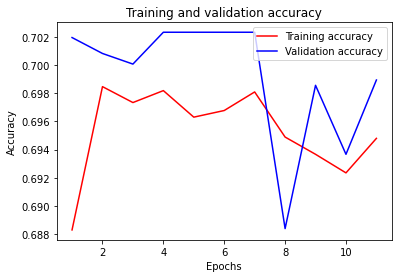

In [45]:
# learning curve
import matplotlib.pyplot as plt

# accuracy
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

# loss
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

### 3.5.2 Model Evaluation

In [46]:
# train set evaluation 
# Round to a whole number (0 or 1)
train_preds = np.round(model.predict(X_train),0)

# confusion matrix
confusion_matrix(Y_train, train_preds)

array([[4214, 1101],
       [2039, 3262]])

In [47]:
# validation set evaluation 
# Round to a whole number (0 or 1)
preds = np.round(model.predict(X_test),0)

# confusion matrix
confusion_matrix(Y_test, preds)

array([[1042,  278],
       [ 512,  822]])

In [48]:
# the performance of classification
print(classification_report(Y_test, preds))

              precision    recall  f1-score   support

           0       0.67      0.79      0.73      1320
           1       0.75      0.62      0.68      1334

    accuracy                           0.70      2654
   macro avg       0.71      0.70      0.70      2654
weighted avg       0.71      0.70      0.70      2654



**3rd Model Results:**


*   We have the best recall of 1s in our 3rd model - 62%.
*   Also doing great in accuracy and precision.
*   Comparing to the other 2 models, this model has the highest f1-score of 1s: 68%.
*   The 3rd model is considered as the best model with good overall performance, which would be a good fit for predicting the customers who would possibly default on credit card payments 

# 4.Baseline model - Logistic Regression



In [49]:
# build a logistic regression model as our baseline

from sklearn.linear_model import LogisticRegression

LR = LogisticRegression(max_iter=100000000)
clf = LR.fit(X_train,
             Y_train)

In [50]:
# evaluate test results:
preds = clf.predict(X_test)

confusion_matrix(Y_test, preds)

array([[1111,  209],
       [ 577,  757]])

In [51]:
# evaluate train results:
print(classification_report(Y_test, preds))

              precision    recall  f1-score   support

           0       0.66      0.84      0.74      1320
           1       0.78      0.57      0.66      1334

    accuracy                           0.70      2654
   macro avg       0.72      0.70      0.70      2654
weighted avg       0.72      0.70      0.70      2654



The logistic regression model has a 0 precision of 0.66 and 1 precision of 0.78, as well as an overall accuracy of 0.70. - not bad! But our NN model does a better job than the baseline model!

# 5.Results and Discussion (30 pts)
- Includes learning curves for all models and actual vs. time series plot (if appropriate); for regression - scatterplots, error metrics for train and test partition; for classification or multiclass - confusion matrix and classification report. Includes detailed bullet points that describe what we see from each of the results, ties results to the business problem

In this paper we described deep neural network (DNN) a step by step approach to classify customers default payment in a complete and accurate manner. We achieved better results than previous research in terms of True positive and True negative rate. 

Since our data was imbalanced as the number of customers who defaulted are less we used undersampling to balance our dataset. After undersampling we were left with ~5000 rows. We have created 3 Dense Neural Network and 1 baseline model (Logistic regression) to compare our results so that we can predict if a customer will default or not. So, for this we will focus on the recall value of 1

Model 0 NN: Recall value (1): 0.61, Overall accuracy: 0.71 

Model 1 NN: Recall value (1): 0.60, Overall accuracy: 0.71 

Model 2 NN: Recall value (1): 0.62, Overall accuracy: 0.70 

Logistic regression: Recall value (1): 0.57, Overall accuracy: 0.70 

Based on the above results, we can say Model 2 is the best model.


# 6.Conclusion (5 pts)



1.   The selected model will help credit card companies be vigilant of defaulters. They can take necessary steps (like low credit limit, less payback period etc) before registering the customer for credit card.
2. The credit card company can take some mortgage(non-monetory) from customers who have high potential of a creating a default
3.   This will ultimately help reduce the extra cost which company had to pay for the customers who defaulted.
4. The saved cost can be used to increase the security and identify such 
defaulters early.
5. Detetcting the defaulters early on will help maintain the credit card company its brand value and its authenticity.


# 7.Reference
[1] Taiwan’s Credit Card Crisis, ERIC WANG
https://sevenpillarsinstitute.org/case-studies/taiwans-credit-card-crisis/

[2] Sharma, Sunakshi & Mehra, Vipul. (2018). Default Payment Analysis of Credit Card Clients. 10.13140/RG.2.2.31307.28967. https://www.researchgate.net/publication/326171439_Default_Payment_Analysis_of_Credit_Card_Clients


[3] Shantanu Neema1, * , Benjamin Soibam1.The comparison of machine learning methods to achieve most cost-effective prediction for credit card default.Journal of Management Science and Business Intelligence, 2017, 2–2 August. 2017, pages 36-41 doi: 10.5281/zenodo.851527 http://www.ibii-us.org/Journals/JMSBI/ ISBN 2472-9264 (Online), 2472-9256 (Print)
https://pdfs.semanticscholar.org/def0/9bf8f23bd163c41c22b4ceeff64784ea28b6.pdf


[4] Huang, J., Junyi, C., & Cho, S. (2020). Deep learning in finance and banking: A literature review and classification. Frontiers of Business Research in China, 14(1) doi:http://dx.doi.org.ezproxy.lib.uconn.edu/10.1186/s11782-020-00082-6



[5] T. Hsu, S. Liou, Y. Wang, Y. Huang and Che-Lin, "Enhanced Recurrent Neural Network for Combining Static and Dynamic Features for Credit Card Default Prediction," ICASSP 2019 - 2019 IEEE International Conference on Acoustics, Speech and Signal Processing (ICASSP), Brighton, United Kingdom, 2019, pp. 1572-1576, doi: 10.1109/ICASSP.2019.8682212.
https://ieeexplore.ieee.org/abstract/document/8682212


[6] Hancock, J. T., & Khoshgoftaar, T. M. (2020). Survey on categorical data for neural networks. Journal of Big Data, 7(1) doi:http://dx.doi.org.ezproxy.lib.uconn.edu/10.1186/s40537-020-00305-w

 
[7] I-Cheng Yeh, Che-hui Lien, The comparisons of data mining techniques for the predictive accuracy of probability of default of credit card clients, Expert Systems with Applications, Volume 36, Issue 2, Part 1, 2009, Pages 2473-2480, ISSN 0957-4174, https://doi.org/10.1016/j.eswa.2007.12.020.


[8] Sheikh Rabiul Islam and William Eberle and Sheikh Khaled Ghafoor. 2018. Credit Default Mining Using Combined Machine Learning and Heuristic Approach. https://arxiv.org/ftp/arxiv/papers/1807/1807.01176.pdf
 

[9] W. A. Chishti and S. M. Awan, "Deep Neural Network a Step by Step Approach to Classify Credit Card Default Customer," 2019 International Conference on Innovative Computing (ICIC), Lahore, Pakistan, 2019, pp. 1-8, doi: 10.1109/ICIC48496.2019.8966723.
https://ieeexplore.ieee.org/abstract/document/8966723

[10] Y. Sayjadah, I. A. T. Hashem, F. Alotaibi and K. A. Kasmiran, "Credit Card Default Prediction using Machine Learning Techniques," 2018 Fourth International Conference on Advances in Computing, Communication & Automation (ICACCA), Subang Jaya, Malaysia, 2018, pp. 1-4, doi: 10.1109/ICACCAF.2018.8776802.
https://ieeexplore.ieee.org/document/8776802
